In [1]:
import sys
sys.path.append("../")

In [2]:
import pandas as pd
import plotly.graph_objects as go
from plotting import CandlePlot
import numpy as np

from simulation.pair_trade_percent_binance import PairTradePercent
from technicals.indicators import Donchian_Close

from functools import reduce


from sklearn.preprocessing import StandardScaler

In [3]:

from multiprocessing import Process, Manager
import pickle
import warnings
warnings.filterwarnings('ignore')

In [4]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.ensemble import RandomForestRegressor

In [5]:
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler

In [6]:
from sklearn.linear_model import LinearRegression

def synchronize_dataframes(dfs, df_target, target_name='Target'):
    """
    Sincroniza múltiplos DataFrames pelo timestamp e calcula o índice baseado em regressão multivariada.
    :param dfs: Lista de DataFrames contendo os preços de fechamento dos ativos.
    :param df_target: DataFrame do ativo alvo.
    :param target_name: Nome do ativo alvo (usado no resultado final).
    :return: DataFrame sincronizado com o índice de regressão e o spread.
    """
    # Mesclar todos os DataFrames pelo Timestamp
    df = df_target[['Time', 'Close', 'High', 'Low', 'Volume']].rename(columns={'Close': target_name})
    for i, df_pair in enumerate(dfs):
        df = pd.merge(df, df_pair[['Time', 'Close']].rename(columns={'Close': f'Asset_{i}'}), 
                      on='Time', how='inner')
    return df


def apply_regression(df, target_name, training_size=50000, prediction_size=50000):
    """
    Aplica a regressão em blocos, treinando o modelo com dados históricos e gerando índices para blocos subsequentes.
    :param df: DataFrame com os dados.
    :param target_name: Nome do ativo alvo.
    :param training_size: Tamanho do bloco de dados para treinar o modelo.
    :param prediction_size: Tamanho do bloco de dados para gerar os índices.
    :return: DataFrame atualizado com o índice de regressão calculado.
    """
    asset_columns = [col for col in df.columns if col.startswith('Asset_')]
    total_size = len(df)

    # Inicializar a coluna do índice de regressão com NaN
    regression_index = np.full(total_size, np.nan)

    # Iterar sobre os dados em blocos
    start = 0
    while start + training_size + prediction_size <= total_size:
        # Dados de treinamento
        train_end = start + training_size
        train_data = df.iloc[start:train_end]
        X_train = train_data[asset_columns].values
        y_train = train_data[target_name].values

        # Normalizar os dados de treinamento
        scaler_X = StandardScaler()
        scaler_y = StandardScaler()
        X_train_normalized = scaler_X.fit_transform(X_train)
        y_train_normalized = scaler_y.fit_transform(y_train.reshape(-1, 1)).flatten()

        # Treinar o modelo com os dados do bloco de treinamento
        model = LinearRegression()
        model.fit(X_train_normalized, y_train_normalized)

        # Dados de previsão
        predict_start = train_end
        predict_end = predict_start + prediction_size
        X_predict = df[asset_columns].iloc[predict_start:predict_end].values

        # Normalizar os dados de previsão
        X_predict_normalized = scaler_X.transform(X_predict)

        # Prever o índice
        y_pred_normalized = model.predict(X_predict_normalized)
        y_pred = scaler_y.inverse_transform(y_pred_normalized.reshape(-1, 1)).flatten()

        # Atualizar os índices no array
        regression_index[predict_start:predict_end] = y_pred

        # Avançar para o próximo bloco
        start += prediction_size

    # Adicionar o índice ao DataFrame
    df['Regression_Index'] = regression_index
    return df




def calculate_zscore(df, window, spread_column='Spread'):
    """
    Calcula o Z-Score do spread usando uma janela móvel.
    :param df: DataFrame com a coluna 'Spread'.
    :param spread_column: Nome da coluna de spread.
    :param window: Tamanho da janela para calcular a média e o desvio padrão.
    :return: DataFrame atualizado com a coluna 'Z-Score'.
    """
    df['Spread_Mean'] = df[spread_column].rolling(window=window).mean()
    df['Spread_Std'] = df[spread_column].rolling(window=window).std()
    df['Z-Score'] = (df[spread_column] - df['Spread_Mean']) / df['Spread_Std']
    return df


In [7]:
def run_pair(granularity,
             lenght=10000,
             strategy=1,
             target_asset='VIDTUSDT',
             cluster_asset=['AVAXUSDT','BNBUSDT','LTCUSDT'],
             entry_threshold=3,
             exit_threshold=0,
             window=50
            ):

    # Carregar os DataFrames de ativos
    df_target = pd.read_pickle(f"crypto/{target_asset}_{granularity}.pkl")
    dfs_cluster = [
        pd.read_pickle(f"crypto/{asset}_{granularity}.pkl") for asset in cluster_asset
    ]
    
    
    # Sincronizar e calcular o índice PCA e o spread
    df = synchronize_dataframes(dfs_cluster, df_target, target_name=target_asset)
    
    df = apply_regression(df, target_asset)
    # Remover valores iniciais onde o índice não foi calculado
    df.dropna(inplace=True)
    df.reset_index(drop=True, inplace=True)
    
    # Calcular o spread com o ativo alvo
    df['Spread'] = df[target_asset] - df['Regression_Index']


    # Calcular o Z-Score do spread
    df = calculate_zscore(df, window, spread_column='Spread')

    df['Close_Pair1'] = df[target_asset]
    
    df.dropna(inplace=True)
    df.reset_index(drop=True, inplace=True)

    df['Volume_Mean'] = df['Volume'].rolling(window=20).mean()  # Média de 20 períodos
    df['Volume_75th'] = df['Volume'].rolling(window=100).quantile(0.75)  # 75º percentil

    # Filtro 1: Volume maior que a média dos últimos 20 períodos
    df['Volume_Valid'] = df['Volume'] > df['Volume_Mean']
    
    # Filtro 2: Volume maior que o 75º percentil dos últimos 100 períodos
    df['Volume_Valid'] &= df['Volume'] > df['Volume_75th']
    
    # Filtro 3: Mudança percentual significativa no volume
    df['Volume_Change'] = df['Volume'].pct_change()
    df['Volume_Valid'] &= df['Volume_Change'] > 0.5  # Mudança > 50%
    

    corr = 0
    spread_vol = 0


    df['time'] = df['Time'].copy()
    df['strategy_pair1'] = 0
    # dff['returns'] = dff['Close'].pct_change()
    df['returns_pair1'] = np.log(df['Close_Pair1'] / df['Close_Pair1'].shift(1))
    df['creturns_pair1'] = df['returns_pair1'].cumsum()
    df['Log_Returns_pair1'] = np.log(df['Close_Pair1'] / df['Close_Pair1'].shift(1))
    df['cLog_Returns_pair1'] = df['Log_Returns_pair1'].cumsum()

    # df = df.iloc[lenght:]
    df = df[df['Time'] >= lenght]
    
    df.dropna(inplace=True)
    
    df.reset_index(drop=True, inplace=True)


    

    
    gt = PairTradePercent(
        df,
        strategy,
        entry_threshold,
        exit_threshold,
        corr,
        spread_vol
    )
    
    gt.run_test()
    return gt
    

In [8]:
import pandas as pd

# Carregar os clusters do arquivo
def load_clusters():
    clusters_df = pd.read_csv('best_clusters_overall.csv')
    clusters = {}
    for target_asset in clusters_df['target_asset'].unique():
        clusters[target_asset] = clusters_df[clusters_df['target_asset'] == target_asset]['asset'].tolist()
    return clusters

# Obter os clusters para cada ativo alvo
clusters = load_clusters()


In [9]:
# Verificar os clusters utilizados
for target_asset, cluster_asset in clusters.items():
    print(f"Ativo Alvo: {target_asset}")
    print(f"Cluster: {cluster_asset[:10]}")


Ativo Alvo: DOTUSDT
Cluster: ['MASKUSDT', 'EOSUSDT', 'SANDUSDT']
Ativo Alvo: DOGEUSDT
Cluster: ['CHRUSDT', 'CELOUSDT', 'EOSUSDT']
Ativo Alvo: ADAUSDT
Cluster: ['DASHUSDT', 'PERPUSDT', 'ACHUSDT', 'CHRUSDT', 'TRXUSDT', 'CELOUSDT', 'APTUSDT', 'EOSUSDT', 'XRPUSDT']
Ativo Alvo: XRPUSDT
Cluster: ['PERPUSDT', 'DASHUSDT', 'APTUSDT', 'TRXUSDT', 'ACHUSDT', 'ALGOUSDT', 'ADAUSDT', 'BCHUSDT', 'BANDUSDT', 'EOSUSDT']
Ativo Alvo: TRXUSDT
Cluster: ['CHRUSDT', 'XRPUSDT', 'CELOUSDT', 'EOSUSDT', 'ADAUSDT']
Ativo Alvo: XLMUSDT
Cluster: ['XRPUSDT', 'CHRUSDT', 'ADAUSDT', 'CELOUSDT', 'EOSUSDT']
Ativo Alvo: APTUSDT
Cluster: ['SANDUSDT', 'EOSUSDT', 'LTCUSDT']
Ativo Alvo: VIDTUSDT
Cluster: ['XRPUSDT', 'CHRUSDT', 'ADAUSDT', 'CELOUSDT', 'EOSUSDT']
Ativo Alvo: AVAXUSDT
Cluster: ['SANDUSDT']
Ativo Alvo: LINKUSDT
Cluster: ['APTUSDT']
Ativo Alvo: EOSUSDT
Cluster: ['ALGOUSDT', 'ACHUSDT', 'CELOUSDT', 'CHRUSDT', 'XRPUSDT']
Ativo Alvo: ETCUSDT
Cluster: ['APTUSDT', 'MASKUSDT', 'DOTUSDT', 'ALPHAUSDT', 'DOGEUSDT', 'ALGOUSDT'

In [10]:
# df.columns

In [11]:
def get_list_args():
    args_dic_list = []
    for target_asset, cluster_asset in clusters.items():
        for granularity in ['1m']:
            for lenght in ['2023-01-01 00:00:00']:
                for strategy in [1]:
                    for entry_threshold in [2]:
                        for exit_threshold in [1]:
                            if entry_threshold > exit_threshold:
                                for window in [100]:
                                    args_dic = {
                                        "granularity": granularity,
                                        "lenght": lenght,
                                        "strategy": strategy,
                                        "target_asset": target_asset,
                                        "cluster_asset": cluster_asset,  # Limitar a 10 ativos
                                        "entry_threshold": entry_threshold,
                                        "exit_threshold": exit_threshold,
                                        "window": window
                                    }
                                    args_dic_list.append(args_dic)
    return args_dic_list


In [12]:

def run_process(L, arg):
    # print("PROCESS",arg)
    L.append(
        dict(
            arg=arg,
            target_asset=arg['target_asset'],
            cluster_asset=arg['cluster_asset'],
            granularity=arg['granularity'],
            lenght = arg['lenght'],
            strategy = arg['strategy'],
            entry_threshold = arg['entry_threshold'],
            exit_threshold = arg['exit_threshold'],
            window = arg['window'],
            res=run_pair(
                granularity=arg['granularity'],
                lenght = arg['lenght'],
                strategy= arg['strategy'],
                target_asset=arg['target_asset'],
                cluster_asset=arg['cluster_asset'],
                entry_threshold = arg['entry_threshold'],
                exit_threshold = arg['exit_threshold'],
                window = arg['window']
            )
        )
    )


lista = []
def run_ema_macd():
    with Manager() as manager:
        global lista
        L = manager.list()  # Lista compartilhada entre processos
        args_list = get_list_args()
        print(len(args_list))
        limit = 10
        current = 0
    
        while current < len(args_list):
            print(current)
            processes = []
            todo = len(args_list) - current
            if todo < limit:
                limit = todo
    
            for _ in range(limit):
                processes.append(Process(target=run_process, args=(L, args_list[current])))
                current += 1
    
            for p in processes:
                p.start()
    
            for p in processes:
                p.join()

        print("ALL DONE")
        lista = list(L)

        

In [13]:
%%time

run_ema_macd()

23
0
10
20
ALL DONE
CPU times: user 1.36 s, sys: 6.72 s, total: 8.08 s
Wall time: 39.7 s


In [15]:
# with open(f"./result-pair-trading-new-data-strategy-1-CPA-with-sl-0.05-1min-2023-to-end.pkl", "wb") as f:
#     pickle.dump(lista, f)  # Usa o pickle para salvar o arquivo



In [16]:
# listaa = []

# # Carregar os arquivos e expandir seus conteúdos diretamente na lista principal
# for filename in [
#     "./result-binance-acumulative-percentual-strategy-1-2-3-4-5.pkl",
#     "./result-binance-acumulative-percentual-strategy-6-7-8-9.pkl",
#     "./result-binance-acumulative-percentual-strategy-10-11-12.pkl"
# ]:
#     with open(filename, "rb") as f:
#         listaa.extend(pickle.load(f))
        
# with open(f"./result-binance-acumulative-percentual-strategy-1-12.pkl", "wb") as f:
#     pickle.dump(listaa, f)  # Usa o pickle para salvar o arquivo



In [14]:
res = lista

# with open(f"./result-binance-acumulative-percentual-new-data-strategy-14-1min-2024-split_profit.pkl", "rb") as f:
#     res = pickle.load(f)

In [15]:

dic_res = []
for r in res:

    if r['res'].len_close > 0:
        signal_up = r['res'].df_results.SIGNAL_UP.values[-1]

        res_pos_s = r['res'].df_results[r['res'].df_results['strategy_pair1'] > 0]
        res_neg_s = r['res'].df_results[r['res'].df_results['strategy_pair1'] <= 0]
        sum_neg_s = res_neg_s.strategy_pair1.sum() *-1
        sum_pos_s = res_pos_s.strategy_pair1.sum()
        dic_res.append(
            dict(
                pair1 = r['target_asset'],
                granularity = r['granularity'],
                strat = round(r['res'].df_results.strategy_pair1.sum(),3),
                c = r['res'].df_results['count'].mean(),
                max_o = max(r['res'].df_results.total_opened),
                st = r['res'].strategy,
                entry_threshold = r['entry_threshold'],
                exit_threshold = r['exit_threshold'],
                window = r['window'],
                
                corr = r['res'].corr,
                spread_vol = r['res'].spread_vol,
                s_p_strat = sum_pos_s,
                s_n_strat = sum_neg_s,
                Rel_sum = sum_pos_s/(sum_pos_s+ sum_neg_s),
        
                
                l_p_strat = len(res_pos_s),
                l_n_strat = len(res_neg_s),
                Rel_len = len(res_pos_s)/(len(res_pos_s)+ len(res_neg_s)),

                l_c = r['res'].len_close,
                l_o = r['res'].len_open,
                   

                first_p = r['res'].first_price,
                last_p = r['res'].last_price,

                first_t = r['res'].df_results.start_time.values[0],
                last_t = r['res'].df_results.end_time.values[-1],
                
                r = r['res'].df_results,
                # df = r['res'].df
            )
    )
    # print(f"p={p}  e={e}  dw={dw}  dwp={dwp}   strategy={st}   result={result}")


In [16]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [17]:
df_res = pd.DataFrame(dic_res)

In [22]:
df_res.columns

Index(['pair1', 'granularity', 'strat', 'c', 'max_o', 'st', 'entry_threshold',
       'exit_threshold', 'window', 'corr', 'spread_vol', 's_p_strat',
       's_n_strat', 'Rel_sum', 'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c',
       'l_o', 'first_p', 'last_p', 'first_t', 'last_t', 'r'],
      dtype='object')

In [23]:
# Exibir todas as linhas
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

df_res.head(150)[['pair1', 'granularity', 'strat', 'c', 'max_o', 'st', 'entry_threshold',
       'window', 'corr', 'spread_vol', 's_p_strat', 's_n_strat', 'Rel_sum',
       'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o']]

,pair1,granularity,strat,c,max_o,st,entry_threshold,window,corr,spread_vol,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o
0,LINKUSDT,1m,-8.613,20.318571,1,1,2,100,0,0,18.212597,26.825438,0.404383,7538,6823,0.524894,14361,0
1,AVAXUSDT,1m,-6.079,17.715296,1,1,2,100,0,0,22.831905,28.911124,0.441256,8807,7315,0.546272,16122,0
2,APTUSDT,1m,-4.461,17.761759,1,1,2,100,0,0,28.221196,32.682506,0.463374,8629,7401,0.538303,16030,1
3,DOTUSDT,1m,-9.842,17.993959,1,1,2,100,0,0,15.912715,25.754396,0.381901,6526,9199,0.415008,15725,0
4,DOGEUSDT,1m,-10.351,17.387826,1,1,2,100,0,0,19.949873,30.300991,0.397006,6736,9462,0.415854,16198,0
5,VIDTUSDT,1m,16.152,15.111415,1,1,2,100,0,0,45.573599,29.421176,0.607690,11044,5058,0.685878,16102,0
6,TRXUSDT,1m,-10.896,20.091468,1,1,2,100,0,0,4.874411,15.770296,0.236109,4077,10573,0.278294,14650,0
7,XLMUSDT,1m,3.462,13.458419,1,1,2,100,0,0,21.082829,17.620579,0.544728,13565,6264,0.684099,19829,0
8,ADAUSDT,1m,-9.036,18.497413,1,1,2,100,0,0,16.861176,25.897151,0.394337,6487,9170,0.414319,15657,0
9,XRPUSDT,1m,-8.907,19.782457,1,1,2,100,0,0,15.002322,23.908939,0.385552,6021,8583,0.412284,14604,1


NameError: name 'df' is not defined

2636 3524


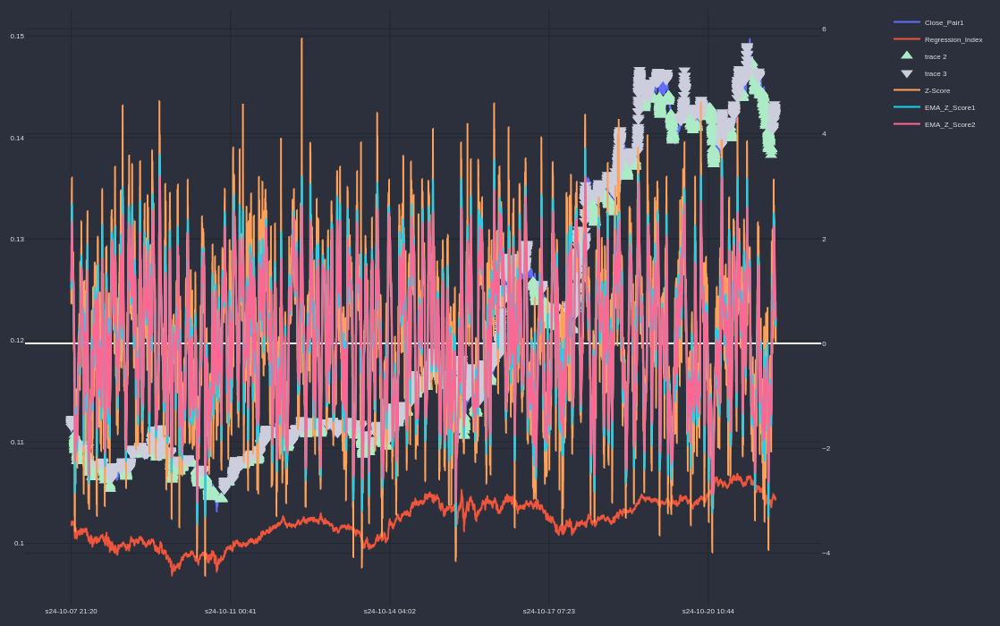

In [35]:
ddf = lista[4]['res'].df.copy()

ddf['EMA_Z_Score1'] = ddf['Z-Score'].ewm(span=10, min_periods=10).mean()
ddf['EMA_Z_Score2'] = ddf['Z-Score'].ewm(span=20, min_periods=20).mean()

cp = CandlePlot(ddf.iloc[-20000:],candles=False)


trades_up = cp.df_plot[cp.df_plot.SIGNAL_UP_PAIR1 == 1]

trades_down = cp.df_plot[cp.df_plot.SIGNAL_DOWN_PAIR1 == 1]

print(len(trades_up),len(trades_down))

marker_trade_up = '#abebc6'
marker_trade_down = '#cccddd'


markers = 'Close_Pair1'


cp.add_traces(['Close_Pair1','Regression_Index'])


# # SIGNAL UP
cp.fig.add_trace(go.Scatter(
    x = trades_up.sTime,
    y = trades_up[markers],
    mode = 'markers',
    marker_symbol = 'triangle-up',
    marker=dict(color=marker_trade_up, size=12)
))

cp.fig.add_trace(go.Scatter(
    x = trades_down.sTime,
    y = trades_down[markers],
    mode = 'markers',
    marker_symbol = 'triangle-down',
    marker=dict(color=marker_trade_down, size=12)
))


cp.show_plot(height=700, width=1100, sec_traces=['Z-Score','EMA_Z_Score1','EMA_Z_Score2'])

In [22]:
# df_sorted_desc.iloc[4].r['time'] = df_sorted_desc.iloc[4].r['end_time']
# df_sorted_desc.iloc[4].r['GAIN_C'] = df_sorted_desc.iloc[4].r.strategy.cumsum()

# cp = CandlePlot(df_sorted_desc.iloc[4].r, candles=False)
# cp.show_plot(line_traces = ['GAIN_C'])

In [23]:
def rank_backtest_results(df):
    # Definindo pesos para cada coluna com base na importância
    weights = {
        'strat': 0.4,           # Retorno acumulado percentual (maximizar)
        'Rel_sum': 0.2,        # Relação de resultados positivos/negativos (maximizar)
    }
    
    # Normalizando as colunas relevantes
    for col in weights.keys():
        df[col + '_norm'] = (df[col] - df[col].min()) / (df[col].max() - df[col].min())
    
    # Calculando o score ponderado para cada linha
    df['score'] = sum(
        df[col + '_norm'] * weight if weight >= 0 else (1 - df[col + '_norm']) * abs(weight) 
        for col, weight in weights.items()
    )
    
    # Ordenando o DataFrame pelos melhores resultados com base no score
    df_sorted = df.sort_values(by='score', ascending=False).reset_index(drop=True)
    
    # Removendo colunas de normalização temporárias
    df_sorted.drop(columns=[col + '_norm' for col in weights.keys()], inplace=True)
    
    return df_sorted

In [24]:
pairs = ['DOTUSDT','DOGEUSDT','ADAUSDT','XRPUSDT','TRXUSDT','XLMUSDT','APTUSDT','VIDTUSDT','BTCUSDT',
          'ETHUSDT','AVAXUSDT','BNBUSDT','LTCUSDT','LINKUSDT',
         'BCHUSDT','EOSUSDT','ETCUSDT','DASHUSDT','ALGOUSDT','SANDUSDT',
         'ARUSDT', 'INJUSDT', 'MASKUSDT', 'CELOUSDT', 'BANDUSDT', 'ALPHAUSDT', 'PERPUSDT',
         'ACHUSDT', 'CHRUSDT', 'BELUSDT']

In [25]:
# df_APTUSDT = df_res[df_res['pair']=='APTUSDT']
# df_DOTUSDT = df_res[df_res['pair']=='DOTUSDT']
# df_DOGEUSDT = df_res[df_res['pair']=='DOGEUSDT']
# df_ADAUSDT = df_res[df_res['pair']=='ADAUSDT']
# df_XRPUSDT = df_res[df_res['pair']=='XRPUSDT']
# df_VIDTUSDT = df_res[df_res['pair']=='VIDTUSDT']
# df_TRXUSDT = df_res[df_res['pair']=='TRXUSDT']
# df_XLMUSDT = df_res[df_res['pair']=='XLMUSDT']

In [26]:
# rank_APT = rank_backtest_results(df_APTUSDT)
# rank_DOT = rank_backtest_results(df_DOTUSDT)
# rank_DOGE = rank_backtest_results(df_DOGEUSDT)
# rank_ADA = rank_backtest_results(df_ADAUSDT)
# rank_XRP = rank_backtest_results(df_XRPUSDT)
# rank_VIDT = rank_backtest_results(df_VIDTUSDT)
# rank_TRX = rank_backtest_results(df_TRXUSDT)
# rank_XLM = rank_backtest_results(df_XLMUSDT)



In [27]:
# Lista de pares
pairs = ['DOTUSDT','DOGEUSDT','ADAUSDT','XRPUSDT','TRXUSDT','XLMUSDT','APTUSDT','VIDTUSDT','BTCUSDT',
         'ETHUSDT','AVAXUSDT','BNBUSDT','LTCUSDT','LINKUSDT',
         'BCHUSDT','EOSUSDT','ETCUSDT','DASHUSDT','ALGOUSDT','SANDUSDT',
         'ARUSDT', 'INJUSDT', 'MASKUSDT', 'CELOUSDT', 'BANDUSDT', 'ALPHAUSDT', 'PERPUSDT',
         'ACHUSDT', 'CHRUSDT', 'BELUSDT']

# Dicionários para armazenar DataFrames e ranks
df_dict = {}
rank_dict = {}

# Loop para criar DataFrames e calcular ranks
for pair in pairs:
    df_dict[pair] = df_res[df_res['pair1'] == pair]
    rank_dict[pair] = rank_backtest_results(df_dict[pair])



In [28]:
# Exemplo de como acessar os resultados
df_dict['DOTUSDT'].columns  # DataFrame do par DOTUSDT


Index(['pair1', 'granularity', 'strat', 'c', 'max_o', 'st', 'entry_threshold',
       'exit_threshold', 'window', 'corr', 'spread_vol', 's_p_strat',
       's_n_strat', 'Rel_sum', 'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c',
       'l_o', 'first_p', 'last_p', 'first_t', 'last_t', 'r', 'strat_norm',
       'Rel_sum_norm', 'score'],
      dtype='object')

In [29]:
mean_dict = []
for pair in pairs:
    dic_ = {
        "pair": pair,
        "strat": round(rank_dict[pair].strat.mean(),2),
        "rel_sum": round(rank_dict[pair].Rel_sum.mean(),2)
    }
    mean_dict.append(dic_)
    
df_mean = pd.DataFrame(mean_dict)

df_mean = df_mean.sort_values(by='strat', ascending=False).reset_index(drop=True)
df_mean

,pair,strat,rel_sum
0,VIDTUSDT,5.71,0.62
1,CELOUSDT,1.97,0.53
2,ALPHAUSDT,1.55,0.56
3,XLMUSDT,1.15,0.57
4,DASHUSDT,0.89,0.58
5,EOSUSDT,0.60,0.51
6,ARUSDT,0.36,0.49
7,ALGOUSDT,-0.56,0.51
8,PERPUSDT,-0.67,0.55
9,ACHUSDT,-0.72,0.52


In [30]:
rank_dict['VIDTUSDT'] = rank_dict['VIDTUSDT'].round(2)
rank_dict['VIDTUSDT'].head(350)[['pair1', 'strat', 'c', 'max_o',
       'entry_threshold','exit_threshold','window', 's_p_strat', 's_n_strat',
       'Rel_sum', 'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o']]

,pair1,strat,c,max_o,entry_threshold,exit_threshold,window,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o
0,VIDTUSDT,16.04,15.00,1,2,1,100,45.67,29.63,0.61,11082,5142,0.68,16224,0
1,VIDTUSDT,7.42,19.12,1,3,1,100,21.33,13.91,0.61,3237,1557,0.68,4794,0
2,VIDTUSDT,0.78,18.14,1,6,1,100,1.51,0.73,0.67,119,59,0.67,178,0
3,VIDTUSDT,3.16,19.13,1,4,1,100,8.80,5.65,0.61,907,462,0.66,1369,0
4,VIDTUSDT,1.15,17.38,1,5,1,100,3.91,2.76,0.59,312,182,0.63,494,0


In [31]:
rank_dict['XLMUSDT'] = rank_dict['XLMUSDT'].round(2)
rank_dict['XLMUSDT'].head(350)[['pair1', 'strat', 'c', 'max_o',
       'entry_threshold','exit_threshold','window', 's_p_strat', 's_n_strat',
       'Rel_sum', 'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o']]

,pair1,strat,c,max_o,entry_threshold,exit_threshold,window,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o
0,XLMUSDT,3.44,13.45,1,2,1,100,21.04,17.60,0.54,13573,6270,0.68,19843,0
1,XLMUSDT,0.19,23.15,1,6,1,100,0.57,0.38,0.60,47,44,0.52,91,0
2,XLMUSDT,0.65,24.03,1,4,1,100,2.38,1.73,0.58,360,230,0.61,590,0
3,XLMUSDT,0.30,23.93,1,5,1,100,0.98,0.68,0.59,106,85,0.55,191,0
4,XLMUSDT,1.19,21.26,1,3,1,100,7.45,6.26,0.54,2528,1454,0.63,3982,0


In [32]:
rank_dict['DASHUSDT'] = rank_dict['DASHUSDT'].round(2)
rank_dict['DASHUSDT'].head(350)[['pair1', 'strat', 'c', 'max_o',
       'entry_threshold','exit_threshold','window', 's_p_strat', 's_n_strat',
       'Rel_sum', 'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o']]

,pair1,strat,c,max_o,entry_threshold,exit_threshold,window,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o
0,DASHUSDT,1.88,22.95,1,3,1,100,9.29,7.41,0.56,2527,1563,0.62,4090,0
1,DASHUSDT,0.35,24.83,1,6,1,100,0.75,0.40,0.65,73,43,0.63,116,0
2,DASHUSDT,0.52,24.19,1,5,1,100,1.40,0.89,0.61,151,97,0.61,248,0
3,DASHUSDT,1.06,16.94,1,2,1,100,21.79,20.73,0.51,9518,6508,0.59,16026,0
4,DASHUSDT,0.64,24.68,1,4,1,100,2.98,2.35,0.56,495,326,0.60,821,0


In [33]:
rank_dict['ALPHAUSDT'] = rank_dict['ALPHAUSDT'].round(2)
rank_dict['ALPHAUSDT'].head(350)[['pair1', 'strat', 'c', 'max_o',
       'entry_threshold','exit_threshold','window', 's_p_strat', 's_n_strat',
       'Rel_sum', 'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o']]

,pair1,strat,c,max_o,entry_threshold,exit_threshold,window,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o
0,ALPHAUSDT,3.51,15.48,1,2,1,100,32.70,29.19,0.53,10822,6367,0.63,17189,0
1,ALPHAUSDT,0.76,16.97,1,6,1,100,1.69,0.94,0.64,97,76,0.56,173,0
2,ALPHAUSDT,2.11,21.63,1,3,1,100,13.70,11.58,0.54,2642,1762,0.60,4404,0
3,ALPHAUSDT,1.01,21.74,1,4,1,100,4.98,3.97,0.56,541,412,0.57,953,0
4,ALPHAUSDT,0.38,19.51,1,5,1,100,2.38,2.00,0.54,185,160,0.54,345,0


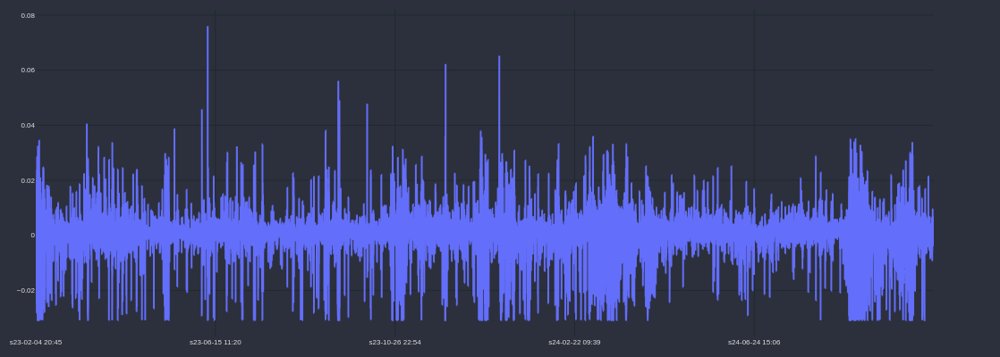

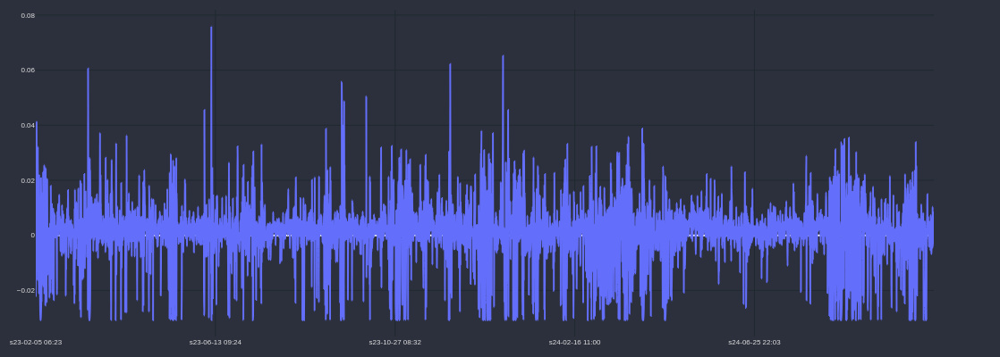

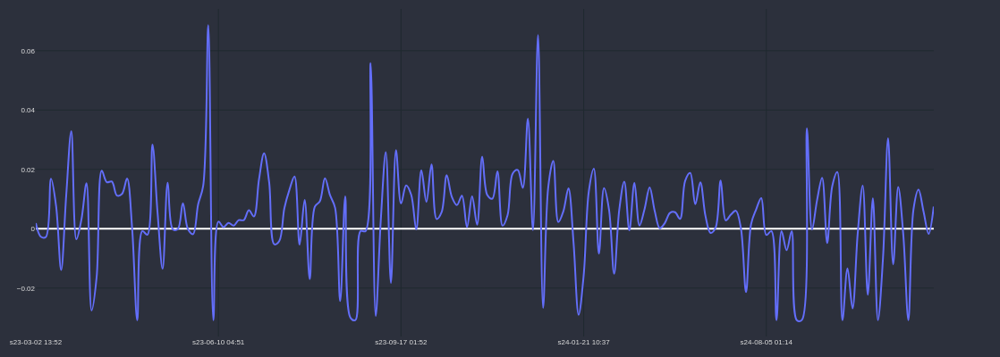

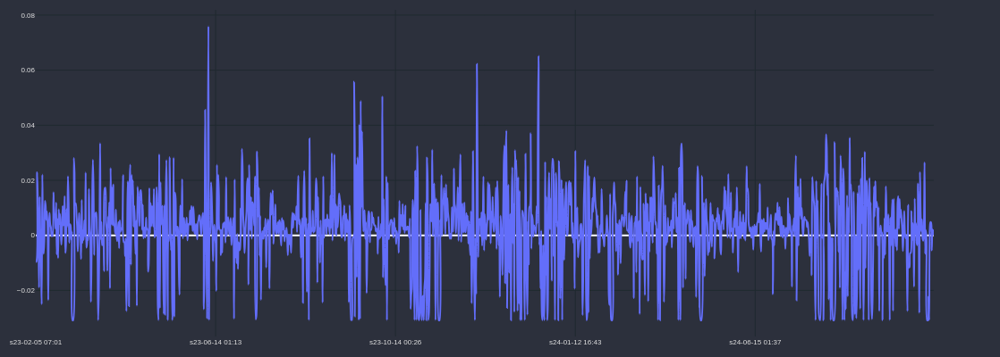

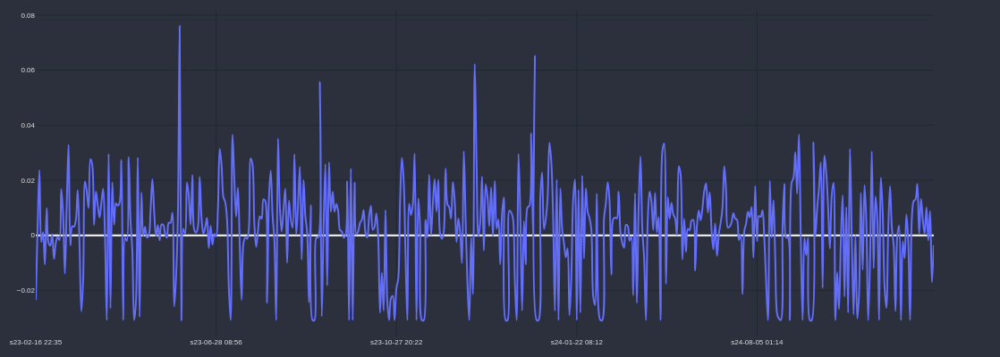

In [34]:
for index in range(len(rank_dict['VIDTUSDT'])):
    rank = rank_dict['VIDTUSDT'].iloc[index]
    rank.r['time'] = rank.r['end_time']
    rank.r['GAIN_I'] = rank.r.strategy_pair1

    cp = CandlePlot(rank.r, candles=False)
    cp.show_plot(line_traces = ['GAIN_I'])

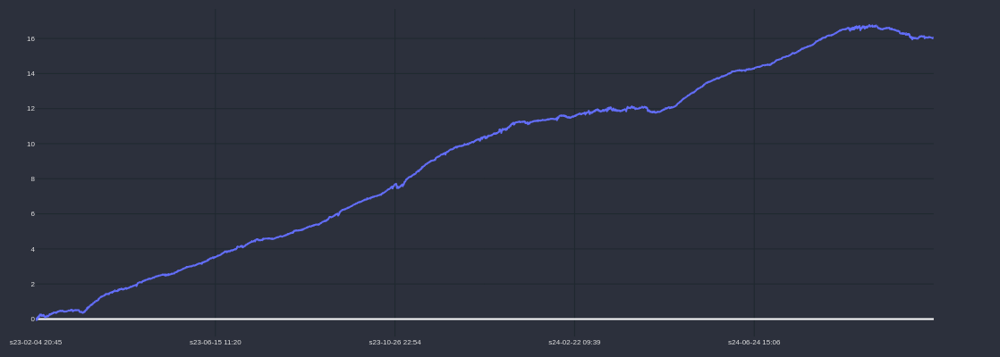

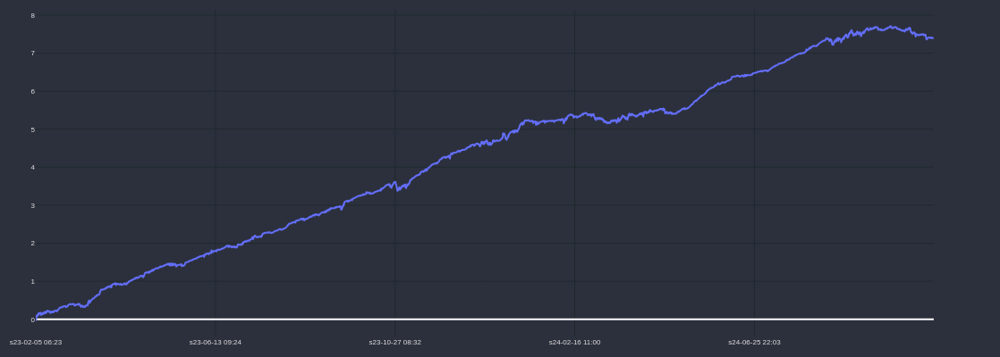

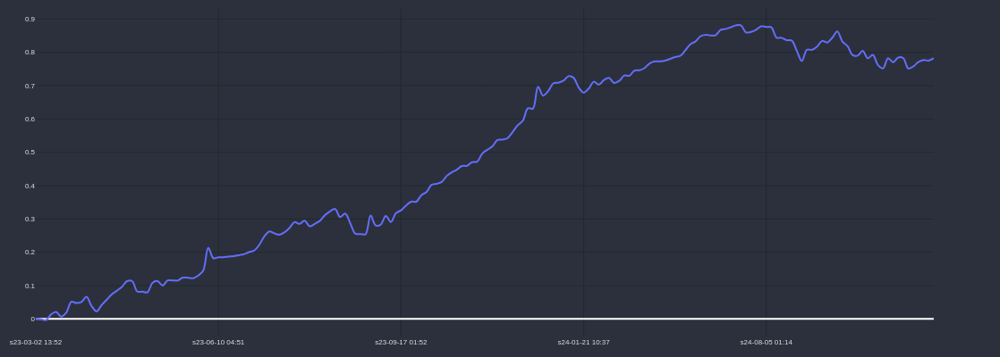

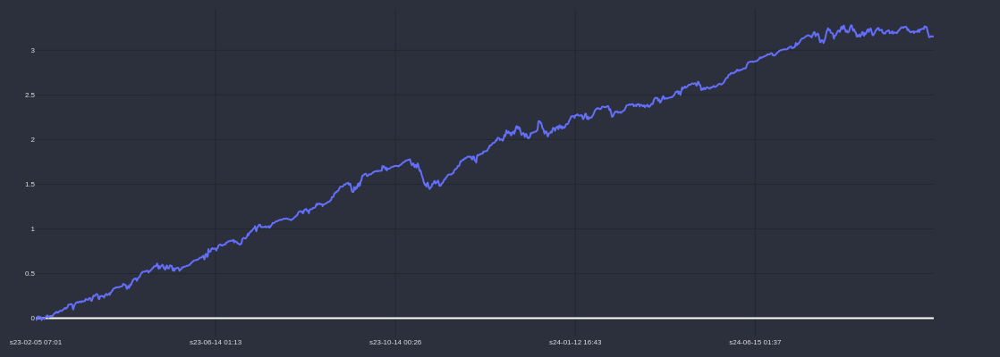

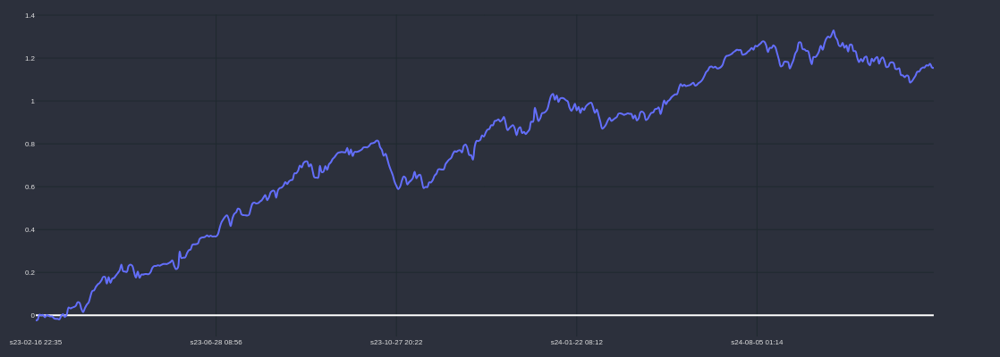

In [35]:
for index in range(len(rank_dict['VIDTUSDT'])):
    rank = rank_dict['VIDTUSDT'].iloc[index]
    rank.r['time'] = rank.r['end_time']
    rank.r['GAIN_I'] = rank.r.strategy_pair1.cumsum()

    cp = CandlePlot(rank.r, candles=False)
    cp.show_plot(line_traces = ['GAIN_I'])

In [35]:
def calcular_operacoes_simultaneas(df):
    # Ordena o DataFrame por start_time para facilitar o cálculo
    df = df.sort_values(by='start_time').reset_index(drop=True)
    # Inicializa a coluna operacoes_simultaneas com o valor mínimo de 0
    df['operacoes_simultaneas'] = 0
    
    # Itera sobre cada operação e conta quantas estão abertas e não fechadas no momento
    for i, row in df.iterrows():
        # Conta quantas operações estão em andamento no tempo de start_time da operação atual
        count = ((df['start_time'] <= row['start_time']) & (df['end_time'] > row['start_time'])).sum()
        # Atualiza a coluna com o número de operações simultâneas, garantindo o mínimo de 1
        df.at[i, 'operacoes_simultaneas'] = max(count, 1)
        
    return df

In [36]:

# Concatenar os DataFrames filtrados, acessando os 10 primeiros elementos do atributo `r` de cada um
concat_ranks = pd.concat(
    [
        rank_dict['VIDTUSDT'].iloc[index].r for index in range(1)
    ]
)


In [37]:
concat_ranks.shape

(15621, 22)

In [38]:
concat_ranks.strategy_pair1.sum()

np.float64(16.49201685887833)

In [39]:
df_test = calcular_operacoes_simultaneas(concat_ranks)
df_test.operacoes_simultaneas.max()

np.int64(1)

In [40]:
df_test.tail()

,running,start_index_m5,count,trigger_type,strategy_pair1,strategy_no_tc,total_opened,first_return,trail_stop_trigger,trailing_stop_target,trailing_stop_loss,stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,time,GAIN_I,operacoes_simultaneas
15616,False,799084,14,0,-0.001452,-0.000652,1,False,0,0.03,-0.03,-0.04,sell,0.03066,0.03068,0,1,-0.00002,2024-10-21 10:52:00,2024-10-21 10:39:00,2024-10-21 10:52:00,16.484797,1
15617,False,799142,6,0,0.000832,0.001632,1,False,0,0.03,-0.03,-0.04,buy,0.03061,0.03066,1,0,0.00005,2024-10-21 11:42:00,2024-10-21 11:37:00,2024-10-21 11:42:00,16.485629,1
15618,False,799211,33,0,0.006700,0.007500,1,False,0,0.03,-0.03,-0.04,sell,0.03078,0.03055,0,1,0.00023,2024-10-21 13:18:00,2024-10-21 12:46:00,2024-10-21 13:18:00,16.492329,1
15619,False,799362,26,0,0.001792,0.002592,1,False,0,0.03,-0.03,-0.04,sell,0.03090,0.03082,0,1,0.00008,2024-10-21 15:42:00,2024-10-21 15:17:00,2024-10-21 15:42:00,16.494121,1
15620,False,799512,17,0,-0.002105,-0.001305,1,False,0,0.03,-0.03,-0.04,buy,0.03068,0.03064,1,0,-0.00004,2024-10-21 18:04:00,2024-10-21 17:47:00,2024-10-21 18:04:00,16.492017,1


In [41]:
concat_ranks.columns

Index(['running', 'start_index_m5', 'count', 'trigger_type', 'strategy_pair1',
       'strategy_no_tc', 'total_opened', 'first_return', 'trail_stop_trigger',
       'trailing_stop_target', 'trailing_stop_loss', 'stop_loss', 'type',
       'start_price', 'trigger_price', 'SIGNAL_UP', 'SIGNAL_DOWN', 'result',
       'end_time', 'start_time', 'time', 'GAIN_I'],
      dtype='object')

In [42]:
df_test.strategy_pair1.sum()

np.float64(16.49201685887833)

In [43]:
(5000/df_test.operacoes_simultaneas.max()) * df_test.strategy_pair1.sum()

np.float64(82460.08429439165)

In [44]:
df_test.tail()

,running,start_index_m5,count,trigger_type,strategy_pair1,strategy_no_tc,total_opened,first_return,trail_stop_trigger,trailing_stop_target,trailing_stop_loss,stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,time,GAIN_I,operacoes_simultaneas
15616,False,799084,14,0,-0.001452,-0.000652,1,False,0,0.03,-0.03,-0.04,sell,0.03066,0.03068,0,1,-0.00002,2024-10-21 10:52:00,2024-10-21 10:39:00,2024-10-21 10:52:00,16.484797,1
15617,False,799142,6,0,0.000832,0.001632,1,False,0,0.03,-0.03,-0.04,buy,0.03061,0.03066,1,0,0.00005,2024-10-21 11:42:00,2024-10-21 11:37:00,2024-10-21 11:42:00,16.485629,1
15618,False,799211,33,0,0.006700,0.007500,1,False,0,0.03,-0.03,-0.04,sell,0.03078,0.03055,0,1,0.00023,2024-10-21 13:18:00,2024-10-21 12:46:00,2024-10-21 13:18:00,16.492329,1
15619,False,799362,26,0,0.001792,0.002592,1,False,0,0.03,-0.03,-0.04,sell,0.03090,0.03082,0,1,0.00008,2024-10-21 15:42:00,2024-10-21 15:17:00,2024-10-21 15:42:00,16.494121,1
15620,False,799512,17,0,-0.002105,-0.001305,1,False,0,0.03,-0.03,-0.04,buy,0.03068,0.03064,1,0,-0.00004,2024-10-21 18:04:00,2024-10-21 17:47:00,2024-10-21 18:04:00,16.492017,1


In [45]:
df_test.describe()

,start_index_m5,count,trigger_type,strategy_pair1,strategy_no_tc,total_opened,trail_stop_trigger,trailing_stop_target,trailing_stop_loss,stop_loss,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,time,GAIN_I,operacoes_simultaneas
count,15621.000000,15621.000000,15621.0,15621.000000,1.562100e+04,15621.0,15621.0,1.562100e+04,1.562100e+04,1.562100e+04,15621.000000,15621.000000,15621.000000,15621.000000,15621.000000,15621,15621,15621,15621.000000,15621.0
mean,386890.494783,15.577876,0.0,0.001056,1.812908e-03,1.0,0.0,3.000000e-02,-3.000000e-02,-4.000000e-02,0.029911,0.029908,0.491134,0.508866,0.000051,2023-12-19 06:06:20.652967168,2023-12-19 05:50:16.458613248,2023-12-19 06:06:20.652967168,9.377601,1.0
min,1.000000,1.000000,0.0,-0.040800,-8.346451e-02,1.0,0.0,3.000000e-02,-3.000000e-02,-4.000000e-02,0.014000,0.013990,0.000000,0.000000,-0.003480,2023-02-04 20:45:00,2023-02-04 20:39:00,2023-02-04 20:45:00,-0.051566,1.0
25%,196363.000000,5.000000,0.0,-0.000800,1.505957e-16,1.0,0.0,3.000000e-02,-3.000000e-02,-4.000000e-02,0.021500,0.021490,0.000000,0.000000,0.000000,2023-07-15 01:35:00,2023-07-15 00:35:00,2023-07-15 01:35:00,4.651494,1.0
50%,368263.000000,10.000000,0.0,0.001461,2.260527e-03,1.0,0.0,3.000000e-02,-3.000000e-02,-4.000000e-02,0.029630,0.029640,0.000000,1.000000,0.000060,2023-12-21 19:50:00,2023-12-21 19:26:00,2023-12-21 19:50:00,10.488693,1.0
75%,584617.000000,21.000000,0.0,0.003575,4.375178e-03,1.0,0.0,3.000000e-02,-3.000000e-02,-4.000000e-02,0.035790,0.035750,1.000000,1.000000,0.000120,2024-05-24 06:37:00,2024-05-24 06:31:00,2024-05-24 06:37:00,13.872252,1.0
max,799512.000000,125.000000,0.0,0.127480,1.282802e-01,1.0,0.0,3.000000e-02,-3.000000e-02,-4.000000e-02,0.067900,0.069160,1.000000,1.000000,0.003430,2024-10-21 18:04:00,2024-10-21 17:47:00,2024-10-21 18:04:00,17.295246,1.0
std,225162.903033,14.792518,0.0,0.007854,8.123302e-03,0.0,0.0,1.387823e-17,1.387823e-17,6.939116e-18,0.009987,0.009981,0.499937,0.499937,0.000295,NaN,NaN,NaN,5.265058,0.0


In [46]:
df_test = df_test.sort_values(by='end_time', ascending=True).reset_index(drop=True)
df_test.head()

,running,start_index_m5,count,trigger_type,strategy_pair1,strategy_no_tc,total_opened,first_return,trail_stop_trigger,trailing_stop_target,trailing_stop_loss,stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,time,GAIN_I,operacoes_simultaneas
0,False,1,7,0,0.002272,0.003072,1,False,0,0.03,-0.03,-0.04,buy,0.04225,0.04238,1,0,0.00013,2023-02-04 20:45:00,2023-02-04 20:39:00,2023-02-04 20:45:00,0.002272,1
1,False,18,35,0,0.002506,0.003306,1,False,0,0.03,-0.03,-0.04,buy,0.04228,0.04242,1,0,0.00014,2023-02-04 21:31:00,2023-02-04 20:56:00,2023-02-04 21:31:00,0.004778,1
2,False,74,6,0,0.007880,0.008680,1,False,0,0.03,-0.03,-0.04,sell,0.04281,0.04244,0,1,0.00037,2023-02-04 21:58:00,2023-02-04 21:53:00,2023-02-04 21:58:00,0.012658,1
3,False,144,17,0,0.001096,0.001896,1,False,0,0.03,-0.03,-0.04,buy,0.04216,0.04224,1,0,0.00008,2023-02-04 23:20:00,2023-02-04 23:04:00,2023-02-04 23:20:00,0.013754,1
4,False,251,11,0,0.000395,0.001195,1,False,0,0.03,-0.03,-0.04,sell,0.04185,0.04180,0,1,0.00005,2023-02-05 01:02:00,2023-02-05 00:52:00,2023-02-05 01:02:00,0.014150,1


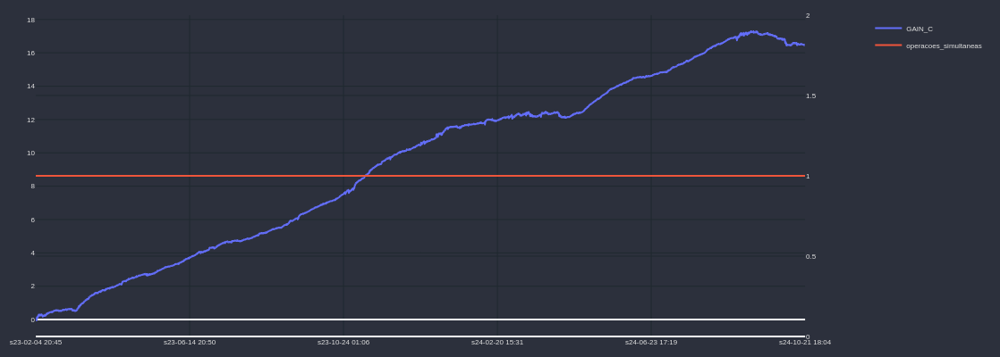

In [47]:

df_test['time'] = df_test['end_time']
df_test['GAIN_C'] = df_test.strategy_pair1.cumsum()

cp = CandlePlot(df_test, candles=False)
cp.show_plot(line_traces = ['GAIN_C'], sec_traces=['operacoes_simultaneas'])

In [48]:
pos = df_test[df_test['strategy_pair1']>0]
neg = df_test[df_test['strategy_pair1']<0]

print(len(pos),len(neg), len(pos)/(len(pos)+len(neg)))

10767 4854 0.6892644516996351


In [49]:
df_test.columns

Index(['running', 'start_index_m5', 'count', 'trigger_type', 'strategy_pair1',
       'strategy_no_tc', 'total_opened', 'first_return', 'trail_stop_trigger',
       'trailing_stop_target', 'trailing_stop_loss', 'stop_loss', 'type',
       'start_price', 'trigger_price', 'SIGNAL_UP', 'SIGNAL_DOWN', 'result',
       'end_time', 'start_time', 'time', 'GAIN_I', 'operacoes_simultaneas',
       'GAIN_C'],
      dtype='object')

In [50]:
import numpy as np
import pandas as pd

def calcular_retorno_dinamico_com_alavancagem(df, saldo_total, alavancagem=1, percentual_capital=10):
    """
    Calcula o retorno acumulado em dólar com controle de reserva, considerando operações simultâneas e mantendo
    o saldo total inalterado até que as operações sejam fechadas. Adiciona incremento de 2% ao capital usado.

    Parâmetros:
        df (pd.DataFrame): DataFrame contendo as colunas `start_time`, `end_time`, e `strategy`.
        saldo_total (float): Saldo total inicial disponível para operações.
        alavancagem (float): Fator de alavancagem a ser aplicado nas operações.
        percentual_capital (float): Percentual do saldo total a ser usado em cada operação.

    Retorno:
        pd.DataFrame: DataFrame atualizado com colunas adicionais e métricas.
    """
    # Ordenar o DataFrame pelo tempo de abertura
    df = df.sort_values(by="start_time").reset_index(drop=True)

    # Inicializar arrays e variáveis
    n = len(df)
    capital_usado = saldo_total / percentual_capital
    incremento_percentual = 0.0

    status = np.full(n, "fechada", dtype=object)
    retorno_dolar = np.zeros(n)
    capital_acumulado = np.full(n, saldo_total)
    saldo_total_arr = np.full(n, saldo_total)
    capital_usado_arr = np.zeros(n)

    for i in range(n):
        # Fechar operações cujo end_time já passou
        abertas = (status == "aberta") & (df["end_time"].values <= df["start_time"].iloc[i])
        for j in np.where(abertas)[0]:
            retorno_alavancado = alavancagem * (df["strategy_pair1"].iloc[j] * capital_usado_arr[j])
            saldo_total += retorno_alavancado  # Atualizar saldo total com o retorno da operação
            retorno_dolar[j] = retorno_alavancado
            status[j] = "fechada"
            # Recalcular o capital usado após fechar uma operação
            capital_usado = saldo_total / percentual_capital

        # Incrementar o capital usado em 2% para a nova operação
        capital_usado *= (1 + incremento_percentual)
        capital_usado_arr[i] = capital_usado

        # Marcar a operação como aberta
        status[i] = "aberta"

        # Atualizar o saldo acumulado e saldo total
        saldo_total_arr[i] = saldo_total
        capital_acumulado[i] = saldo_total

    # Adicionar os resultados ao DataFrame
    df["capital_usado"] = capital_usado_arr
    df["retorno_dolar"] = retorno_dolar
    df["capital_acumulado"] = capital_acumulado
    df["saldo_total"] = saldo_total_arr
    df["status"] = status

    print("Resumo Final:")
    print(f"Saldo total final: ${saldo_total:.2f}")
    return df


In [51]:
df_test.operacoes_simultaneas.mean()

np.float64(1.0)

In [53]:
# valor_inicial = 5.0
saldo_total = 200.0

# Exemplo de uso com alavancagem
df_resultado_dinamico_alavancagem = calcular_retorno_dinamico_com_alavancagem(
    df_test, saldo_total, alavancagem=1, percentual_capital=1
)

Resumo Final:
Saldo total final: $1780212263.60


In [51]:
df_test.strategy_pair1.sum()

np.float64(3.168555484067821)

In [52]:
df_resultado_dinamico_alavancagem[["start_time", "end_time", "strategy_pair1", "capital_usado", "retorno_dolar",
              "capital_acumulado", "saldo_total"]].head(2500)

,start_time,end_time,strategy_pair1,capital_usado,retorno_dolar,capital_acumulado,saldo_total
0,2024-01-01 01:07:00,2024-01-01 01:38:00,0.007753,200.000000,7.753153,200.000000,200.000000
1,2024-01-01 02:13:00,2024-01-01 02:26:00,0.001339,207.753153,1.390947,207.753153,207.753153
2,2024-01-01 04:06:00,2024-01-01 04:59:00,0.006415,209.144100,6.708337,209.144100,209.144100
3,2024-01-01 05:00:00,2024-01-01 05:19:00,0.000286,215.852437,0.309064,215.852437,215.852437
4,2024-01-01 06:45:00,2024-01-01 07:03:00,-0.010793,216.161501,-11.665096,216.161501,216.161501
5,2024-01-01 07:04:00,2024-01-01 07:08:00,0.007759,204.496405,7.933697,204.496405,204.496405
6,2024-01-01 07:22:00,2024-01-01 07:56:00,-0.001159,212.430102,-1.230624,212.430102,212.430102
7,2024-01-01 09:06:00,2024-01-01 09:17:00,0.005266,211.199478,5.560915,211.199478,211.199478
8,2024-01-01 09:50:00,2024-01-01 10:09:00,0.007369,216.760393,7.986655,216.760393,216.760393
9,2024-01-01 13:04:00,2024-01-01 13:40:00,0.003449,224.747048,3.876098,224.747048,224.747048


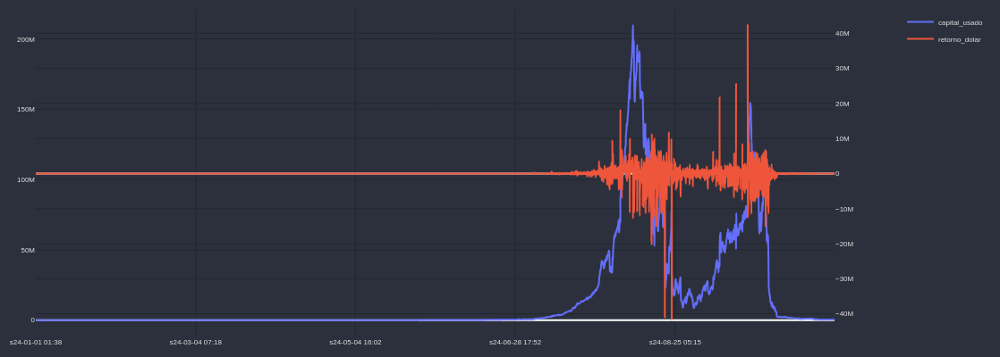

In [53]:
cp = CandlePlot(df_resultado_dinamico_alavancagem, candles=False)
cp.show_plot(line_traces = ['capital_usado'], sec_traces=['retorno_dolar'])

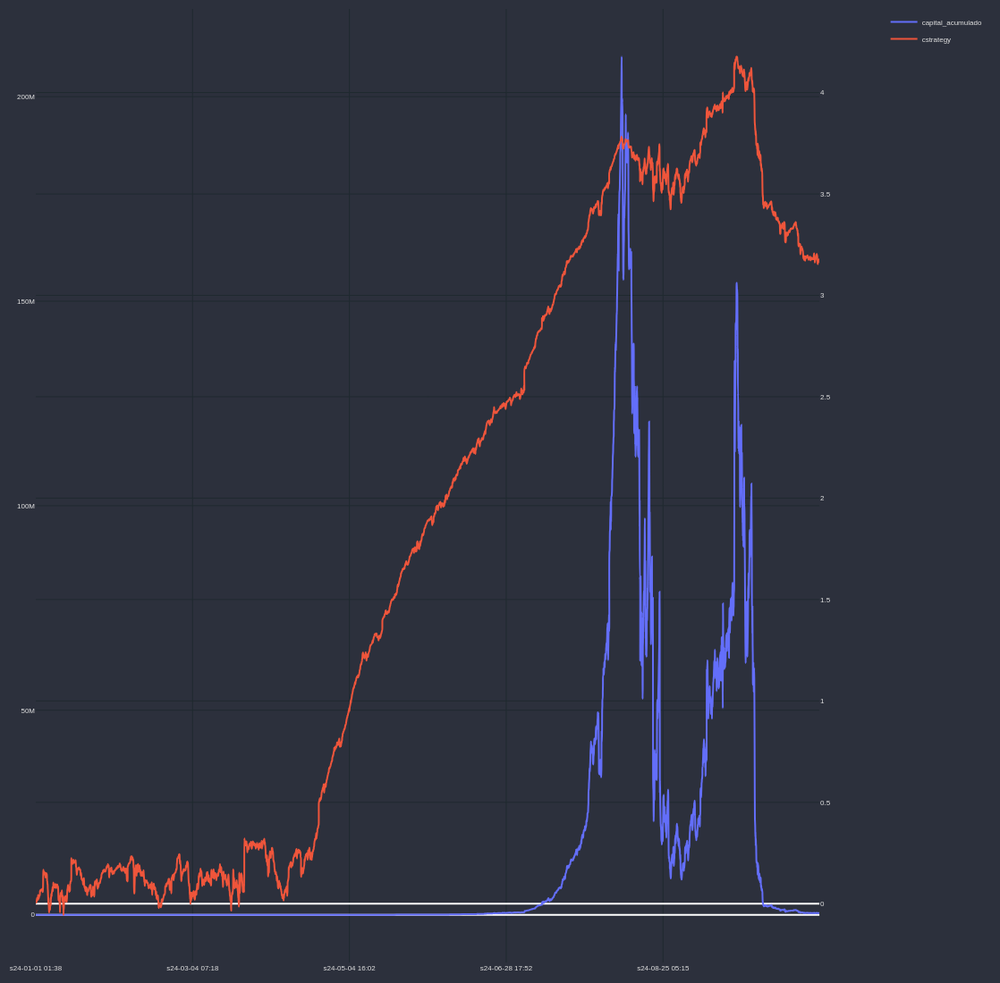

In [54]:
df_resultado_dinamico_alavancagem['cstrategy'] = df_resultado_dinamico_alavancagem.strategy_pair1.cumsum()
cp = CandlePlot(df_resultado_dinamico_alavancagem, candles=False)
cp.show_plot(line_traces = ['capital_acumulado'], sec_traces=['cstrategy'], height=1100)